# Explore here

In [73]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import math
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import pickle
from sklearn.preprocessing import MinMaxScaler
from sklearn.feature_selection import f_classif, SelectKBest
import os
import json
from sklearn.linear_model import LinearRegression

In [40]:
pd.set_option('display.max_columns', None)
total_data = pd.read_csv("/Users/jesus/Desktop/4geeks/4geeks - regularized linear regresion/regularized-linear-reg-machine-learning-python-template/data/raw/demographic_health_data.csv")

total_data.head()

,fips,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,40-49 y/o % of total pop,50-59,50-59 y/o % of total pop,60-69,60-69 y/o % of total pop,70-79,70-79 y/o % of total pop,80+,80+ y/o % of total pop,White-alone pop,% White-alone,Black-alone pop,% Black-alone,Native American/American Indian-alone pop,% NA/AI-alone,Asian-alone pop,% Asian-alone,Hawaiian/Pacific Islander-alone pop,% Hawaiian/PI-alone,Two or more races pop,% Two or more races,POP_ESTIMATE_2018,N_POP_CHG_2018,GQ_ESTIMATES_2018,R_birth_2018,R_death_2018,R_NATURAL_INC_2018,R_INTERNATIONAL_MIG_2018,R_DOMESTIC_MIG_2018,R_NET_MIG_2018,Less than a high school diploma 2014-18,High school diploma only 2014-18,Some college or associate's degree 2014-18,Bachelor's degree or higher 2014-18,Percent of adults with less than a high school diploma 2014-18,Percent of adults with a high school diploma only 2014-18,Percent of adults completing some college or associate's degree 2014-18,Percent of adults with a bachelor's degree or higher 2014-18,POVALL_2018,PCTPOVALL_2018,PCTPOV017_2018,PCTPOV517_2018,MEDHHINC_2018,CI90LBINC_2018,CI90UBINC_2018,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,Median_Household_Income_2018,Med_HH_Income_Percent_of_State_Total_2018,Active Physicians per 100000 Population 2018 (AAMC),Total Active Patient Care Physicians per 100000 Population 2018 (AAMC),Active Primary Care Physicians per 100000 Population 2018 (AAMC),Active Patient Care Primary Care Physicians per 100000 Population 2018 (AAMC),Active General Surgeons per 100000 Population 2018 (AAMC),Active Patient Care General Surgeons per 100000 Population 2018 (AAMC),Total nurse practitioners (2019),Total physician assistants (2019),Total Hospitals (2019),Internal Medicine Primary Care (2019),Family Medicine/General Practice Primary Care (2019),Total Specialist Physicians (2019),ICU Beds_x,Total Population,Population Aged 60+,Percent of Population Aged 60+,COUNTY_NAME,STATE_NAME,STATE_FIPS,CNTY_FIPS,county_pop2018_18 and older,anycondition_prevalence,anycondition_Lower 95% CI,anycondition_Upper 95% CI,anycondition_number,Obesity_prevalence,Obesity_Lower 95% CI,Obesity_Upper 95% CI,Obesity_number,Heart disease_prevalence,Heart disease_Lower 95% CI,Heart disease_Upper 95% CI,Heart disease_number,COPD_prevalence,COPD_Lower 95% CI,COPD_Upper 95% CI,COPD_number,diabetes_prevalence,diabetes_Lower 95% CI,diabetes_Upper 95% CI,diabetes_number,CKD_prevalence,CKD_Lower 95% CI,CKD_Upper 95% CI,CKD_number,Urban_rural_code
0,1001,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,7582,13.636445,7738,13.917016,5826,10.478229,4050,7.284042,2014,3.622237,42660,76.725239,10915,19.630942,267,0.480207,681,1.224798,62,0.111509,1016,1.827305,55601,158,455,11.8,9.6,2.2,0.0,0.7,0.6,4204,12119,10552,10291,11.3,32.6,28.4,27.7,7587,13.8,19.3,19.5,59338,53628,65048,25957,25015,942,3.6,59338,119.0,217.1,196.7,77.2,71.2,7.6,6.9,28.859137,6.085786,1.148905,25.992561,21.249061,72.142154,6,55036,10523,19.1,Autauga,Alabama,1,1,42438,47.6,45.4,49.4,20181,35.8,34.2,37.3,15193,7.9,7.2,8.7,3345,8.6,7.3,9.9,3644,12.9,11.9,13.8,5462,3.1,2.9,3.3,1326,3
1,1003,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,27338,12.539102,29986,13.753658,29932,13.728890,20936,9.602701,9368,4.296814,190301,87.285228,19492,8.940382,1684,0.772399,2508,1.150343,146,0.066966,3891,1.784682,218022,5403,2190,10.5,10.3,0.1,0.5,24.3,24.8,14310,40579,46025,46075,9.7,27.6,31.3,31.3,21069,9.8,13.9,13.1,57588,54437,60739,93849,90456,3393,3.6,57588,115.5,217.1,196.7,77.2,71.2,7.6,6.9,113.162114,23.863512,4.505074,101.921730,83.321572,282.882982,51,203360,53519,26.3,Baldwin,Alabama,1,3,170912,40.2,38.2,42.3,68790,29.7,28.4,31.0,50761,7.8,7.0,8.7,13414,8.6,7.2,10.1,14692,12.0,11.0,13.1,20520,3.2,3.0,3.5,5479,4
2,1005,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,3074,12.354809,3278,13.174712,3076,12.3

- elijo como target --> anycondition_number
- categoricas --> urban_rural_code, county_name, state_name

### Paso 2: Exploración y limpieza de datos

In [41]:
total_data.shape

(3140, 108)

In [42]:
total_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3140 entries, 0 to 3139
Columns: 108 entries, fips to Urban_rural_code
dtypes: float64(61), int64(45), object(2)
memory usage: 2.6+ MB


In [43]:
total_data.isnull().sum().sort_values(ascending = False)

fips                                0
Total nurse practitioners (2019)    0
STATE_NAME                          0
COUNTY_NAME                         0
Percent of Population Aged 60+      0
                                   ..
POP_ESTIMATE_2018                   0
% Two or more races                 0
Two or more races pop               0
% Hawaiian/PI-alone                 0
Urban_rural_code                    0
Length: 108, dtype: int64

In [44]:
total_data.isnull().sum().sort_values(ascending = True)

fips                                   0
COUNTY_NAME                            0
Percent of Population Aged 60+         0
Population Aged 60+                    0
Total Population                       0
                                      ..
Two or more races pop                  0
% Hawaiian/PI-alone                    0
Hawaiian/Pacific Islander-alone pop    0
R_DOMESTIC_MIG_2018                    0
Urban_rural_code                       0
Length: 108, dtype: int64

In [45]:
total_data.duplicated().sum()

np.int64(0)

#### Eliminar información irrelevante

In [46]:
total_data.drop(["STATE_FIPS", "fips", "anycondition_Lower 95% CI", "anycondition_Upper 95% CI", "Obesity_Lower 95% CI", "Obesity_Upper 95% CI", "Heart disease_Lower 95% CI", "Heart disease_Upper 95% CI", "COPD_Lower 95% CI", "COPD_Upper 95% CI", "diabetes_Lower 95% CI", "diabetes_Upper 95% CI", "CKD_Lower 95% CI", "CKD_Upper 95% CI", "R_INTERNATIONAL_MIG_2018", "R_DOMESTIC_MIG_2018", "R_NET_MIG_2018"], axis = 1, inplace = True)
total_data.head()

,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,40-49 y/o % of total pop,50-59,50-59 y/o % of total pop,60-69,60-69 y/o % of total pop,70-79,70-79 y/o % of total pop,80+,80+ y/o % of total pop,White-alone pop,% White-alone,Black-alone pop,% Black-alone,Native American/American Indian-alone pop,% NA/AI-alone,Asian-alone pop,% Asian-alone,Hawaiian/Pacific Islander-alone pop,% Hawaiian/PI-alone,Two or more races pop,% Two or more races,POP_ESTIMATE_2018,N_POP_CHG_2018,GQ_ESTIMATES_2018,R_birth_2018,R_death_2018,R_NATURAL_INC_2018,Less than a high school diploma 2014-18,High school diploma only 2014-18,Some college or associate's degree 2014-18,Bachelor's degree or higher 2014-18,Percent of adults with less than a high school diploma 2014-18,Percent of adults with a high school diploma only 2014-18,Percent of adults completing some college or associate's degree 2014-18,Percent of adults with a bachelor's degree or higher 2014-18,POVALL_2018,PCTPOVALL_2018,PCTPOV017_2018,PCTPOV517_2018,MEDHHINC_2018,CI90LBINC_2018,CI90UBINC_2018,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,Median_Household_Income_2018,Med_HH_Income_Percent_of_State_Total_2018,Active Physicians per 100000 Population 2018 (AAMC),Total Active Patient Care Physicians per 100000 Population 2018 (AAMC),Active Primary Care Physicians per 100000 Population 2018 (AAMC),Active Patient Care Primary Care Physicians per 100000 Population 2018 (AAMC),Active General Surgeons per 100000 Population 2018 (AAMC),Active Patient Care General Surgeons per 100000 Population 2018 (AAMC),Total nurse practitioners (2019),Total physician assistants (2019),Total Hospitals (2019),Internal Medicine Primary Care (2019),Family Medicine/General Practice Primary Care (2019),Total Specialist Physicians (2019),ICU Beds_x,Total Population,Population Aged 60+,Percent of Population Aged 60+,COUNTY_NAME,STATE_NAME,CNTY_FIPS,county_pop2018_18 and older,anycondition_prevalence,anycondition_number,Obesity_prevalence,Obesity_number,Heart disease_prevalence,Heart disease_number,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code
0,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,7582,13.636445,7738,13.917016,5826,10.478229,4050,7.284042,2014,3.622237,42660,76.725239,10915,19.630942,267,0.480207,681,1.224798,62,0.111509,1016,1.827305,55601,158,455,11.8,9.6,2.2,4204,12119,10552,10291,11.3,32.6,28.4,27.7,7587,13.8,19.3,19.5,59338,53628,65048,25957,25015,942,3.6,59338,119.0,217.1,196.7,77.2,71.2,7.6,6.9,28.859137,6.085786,1.148905,25.992561,21.249061,72.142154,6,55036,10523,19.1,Autauga,Alabama,1,42438,47.6,20181,35.8,15193,7.9,3345,8.6,3644,12.9,5462,3.1,1326,3
1,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,27338,12.539102,29986,13.753658,29932,13.728890,20936,9.602701,9368,4.296814,190301,87.285228,19492,8.940382,1684,0.772399,2508,1.150343,146,0.066966,3891,1.784682,218022,5403,2190,10.5,10.3,0.1,14310,40579,46025,46075,9.7,27.6,31.3,31.3,21069,9.8,13.9,13.1,57588,54437,60739,93849,90456,3393,3.6,57588,115.5,217.1,196.7,77.2,71.2,7.6,6.9,113.162114,23.863512,4.505074,101.921730,83.321572,282.882982,51,203360,53519,26.3,Baldwin,Alabama,3,170912,40.2,68790,29.7,50761,7.8,13414,8.6,14692,12.0,20520,3.2,5479,4
2,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,3074,12.354809,3278,13.174712,3076,12.362847,2244,9.018930,1048,4.212049,12209,49.069571,12042,48.398376,164,0.659137,113,0.454162,46,0.184880,307,1.233873,24881,-277,2820,10.4,12.9,-2.5,4901,6486,4566,2220,27.0,35.7,25.1,12.2,6788,30.9,43.9,36.7,34382,31157,37607,8373,7940,433,5.2,34382,68.9,217.1,196.7,77.2,71.2,7.6,6.9,12.914231,2.723340,0.514126,11.631462,9.508784,32.283033,5,26201,6150,23.5,Barbour,Alabama,5,19689,57.5,11325,40.7,8013,11.0,2159,12.1,2373,19.7,3870,4.5,887,6
3,22400,2456,10.964286,2596,11.589286,3029,13.5

### Paso 3: Análisis de variables univariante

#### Análisis sobre variables categóricas

categoricas --> urban_rural_code, county_name, state_name

/var/folders/72/kf09dnsd1wb18f08628cdsxm0000gn/T/ipykernel_6305/1973929014.py:28: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="center", fontsize=10)
/var/folders/72/kf09dnsd1wb18f08628cdsxm0000gn/T/ipykernel_6305/1973929014.py:28: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="center", fontsize=10)
/var/folders/72/kf09dnsd1wb18f08628cdsxm0000gn/T/ipykernel_6305/1973929014.py:28: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="center", fontsize=10)


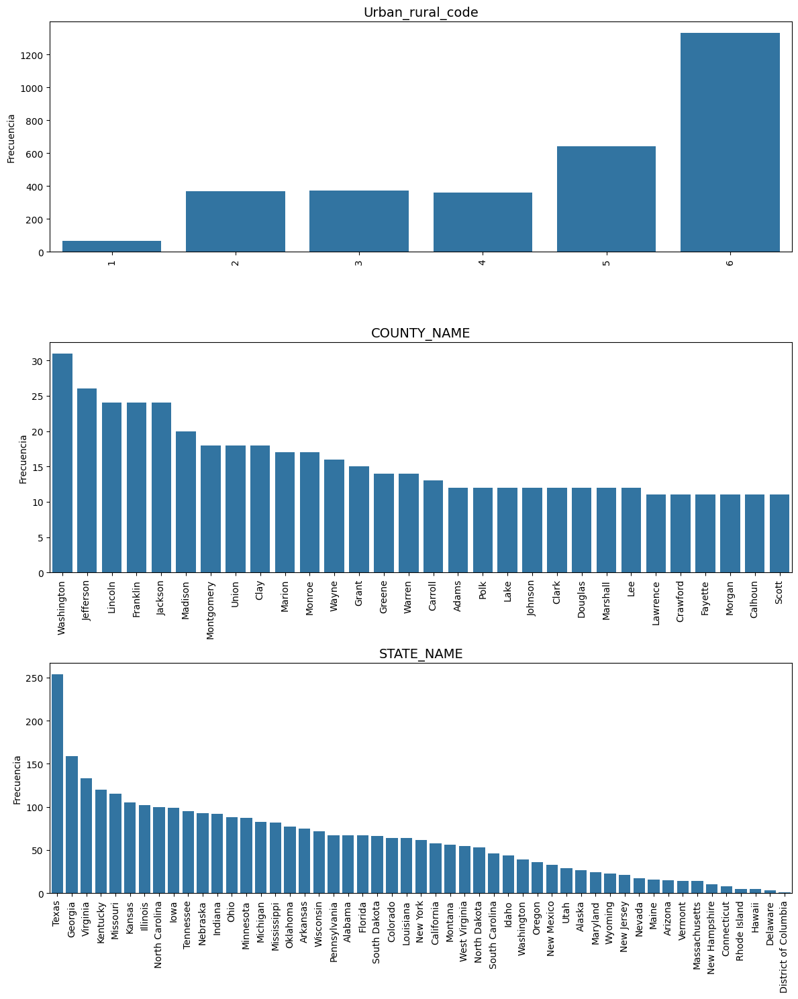

In [47]:
# Lista de columnas categóricas
categorical_variables = ["Urban_rural_code", "COUNTY_NAME", "STATE_NAME"]

# Número de filas
num_rows = len(categorical_variables)

# Ajustar el tamaño de la figura
fig, axes = plt.subplots(num_rows, 1, figsize=(12, 5 * num_rows))

# Asegurar que axes sea iterable cuando hay solo una variable
if num_rows == 1:
    axes = [axes]

for i, column_name in enumerate(categorical_variables):
    ax = axes[i]
    
    # Contar frecuencia de categorías
    category_counts = total_data[column_name].value_counts().sort_values(ascending=False)
    
    # Si hay demasiadas categorías en COUNTY_NAME, mostramos solo las más comunes
    if column_name == "COUNTY_NAME" and len(category_counts) > 30:
        category_counts = category_counts[:30]  # Solo mostramos las 30 más comunes
    
    # Gráfico de barras en lugar de histograma
    sns.barplot(x=category_counts.index, y=category_counts.values, ax=ax)
    
    # Rotar etiquetas a 90 grados en horizontal
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="center", fontsize=10)

    ax.set_title(column_name, fontsize=14)  # Agregar título con el nombre de la columna
    ax.set_ylabel("Frecuencia")
    ax.set_xlabel("")

plt.tight_layout()
plt.show()



La frecuencia más común en urban_rural_code es la 6 que corresponde a "Urban population of 2,500 to 19,999, adjacent to a metro area", los datos mayoritarios son de Washington, Jefferson, Lincoln, Franklin y Jackson y el Estado más destacado es Texas seguido de Georgia.

#### Análisis sobre variables numéricas

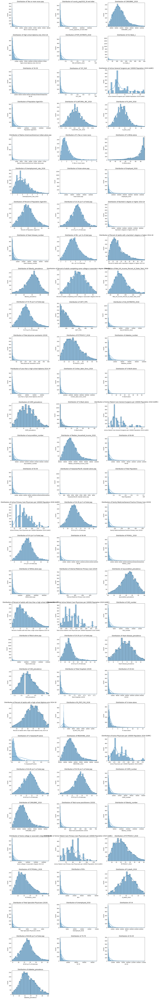

In [ ]:
# Lista de variables numéricas
numericals_variables = list(set(total_data.columns) - set(categorical_variables))

# Configurar el número de columnas y calcular filas necesarias
ncols = 3
nrows = int(np.ceil(len(numericals_variables) / ncols))  # Redondear hacia arriba

# Crear la figura con varias columnas
fig, axes = plt.subplots(nrows, ncols, figsize=(20, nrows * 5))

# Convertir `axes` en un array 1D para iterar fácilmente
axes = axes.flatten()

for i, col in enumerate(numericals_variables):
    # Establecer límites automáticos usando percentil 1 y 99 para evitar outliers extremos
    q1, q99 = total_data[col].quantile([0.01, 0.99])

    # Histograma en la parte superior del subplot
    sns.histplot(data=total_data, x=col, kde=True, ax=axes[i])
    axes[i].set_title(f'Distribution of {col}')
    axes[i].set_xlim(q1, q99)  # Aplicar límites para mejorar la visualización

# Eliminar ejes vacíos si hay menos gráficos que subgráficos
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Ajustar separación entre gráficos
plt.subplots_adjust(hspace=0.4, wspace=0.3)

plt.show()



### Paso 4: Análisis de variables multivariante

#### Análisis numérico-numérico

/var/folders/72/kf09dnsd1wb18f08628cdsxm0000gn/T/ipykernel_6305/777075642.py:15: UserWarning: Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.
  plt.tight_layout()


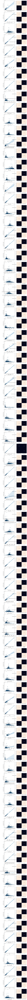

In [52]:
# Crear la variable objetivo
target = total_data["anycondition_number"]
numericals_variables_sin_target = list(set(numericals_variables) - {"target"})

# Crear la figura y los ejes
num_rows = len(numericals_variables_sin_target)
fig, axis = plt.subplots(num_rows, 2, figsize=(10, 5 * num_rows))

# Crear gráficos para cada variable
for i, var in enumerate(numericals_variables_sin_target):
    sns.regplot(ax=axis[i, 0], data=total_data, x=var, y=target, scatter_kws={'edgecolor': 'k', 'alpha': 0.6})
    sns.heatmap(total_data[[target.name, var]].corr(), annot=True, fmt=".2f", ax=axis[i, 1], cbar=False)

# Ajustar el layout
plt.tight_layout()

# Mostrar el plot
plt.show()

#### Análisis categórico-categórico

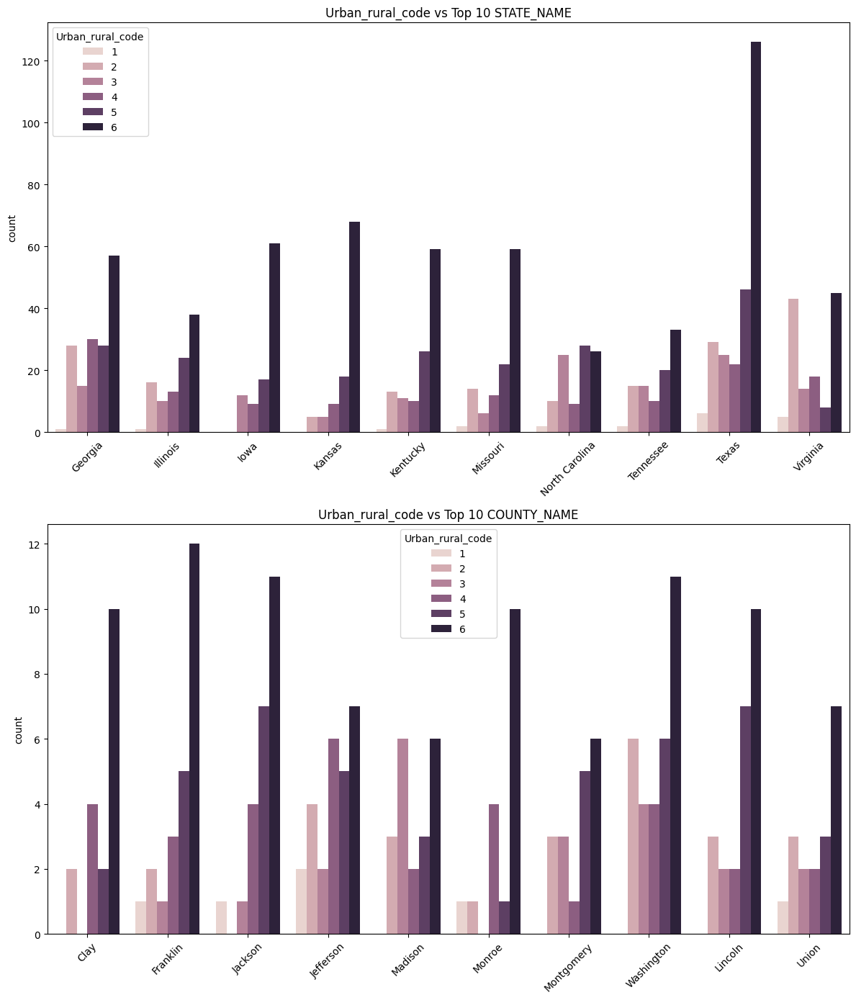

In [56]:
# Filtrar los 10 estados con más datos
top_states = total_data["STATE_NAME"].value_counts().nlargest(10).index
filtered_states = total_data[total_data["STATE_NAME"].isin(top_states)]

# Filtrar los 10 condados más comunes
top_counties = total_data["COUNTY_NAME"].value_counts().nlargest(10).index
filtered_counties = total_data[total_data["COUNTY_NAME"].isin(top_counties)]

fig, axes = plt.subplots(2, 1, figsize=(12, 14))  # Dos gráficos en columna, más grandes

# Urban_rural_code vs. Top 10 STATE_NAME (Barras verticales)
sns.countplot(data=filtered_states, x="STATE_NAME", hue="Urban_rural_code", ax=axes[0])
axes[0].set_title("Urban_rural_code vs Top 10 STATE_NAME")
axes[0].set_xlabel("")
axes[0].tick_params(axis='x', rotation=45)  # Inclina etiquetas para mejor lectura

# Urban_rural_code vs. Top 10 COUNTY_NAME (Barras verticales)
sns.countplot(data=filtered_counties, x="COUNTY_NAME", hue="Urban_rural_code", ax=axes[1])
axes[1].set_title("Urban_rural_code vs Top 10 COUNTY_NAME")
axes[1].set_xlabel("")
axes[1].tick_params(axis='x', rotation=45)  # Inclina etiquetas para mejor lectura

plt.tight_layout()
plt.show()



##### Combinaciones de la clase con varias predictoras

In [ ]:
logical_combinations = [
    ('Urban_rural_code', 'STATE_NAME'),
    ('Urban_rural_code', 'COUNTY_NAME')
]

# Configurar el tamaño de la figura
fig, axes = plt.subplots(1, 2, figsize=(20, 10))

# Iterar sobre las combinaciones y crear los gráficos
for idx, (cat1, cat2) in enumerate(logical_combinations):
    ax = axes[idx]
    sns.countplot(data=total_data, x=cat1, hue=cat2, ax=ax)
    ax.set_title(f'{cat1} vs {cat2}')
    ax.tick_params(axis='x', rotation=90)  # Rotar etiquetas para mejor visualización

plt.tight_layout()
plt.show()


- elijo como target --> anycondition_number
- categoricas --> urban_rural_code, county_name, state_name

/var/folders/72/kf09dnsd1wb18f08628cdsxm0000gn/T/ipykernel_6305/4014933287.py:34: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
/var/folders/72/kf09dnsd1wb18f08628cdsxm0000gn/T/ipykernel_6305/4014933287.py:34: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
/var/folders/72/kf09dnsd1wb18f08628cdsxm0000gn/T/ipykernel_6305/4014933287.py:34: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
/var/folders/72/kf09dnsd1wb18f08628cdsxm0000gn/T/ipykernel_6305/4014933287.py:34: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedL

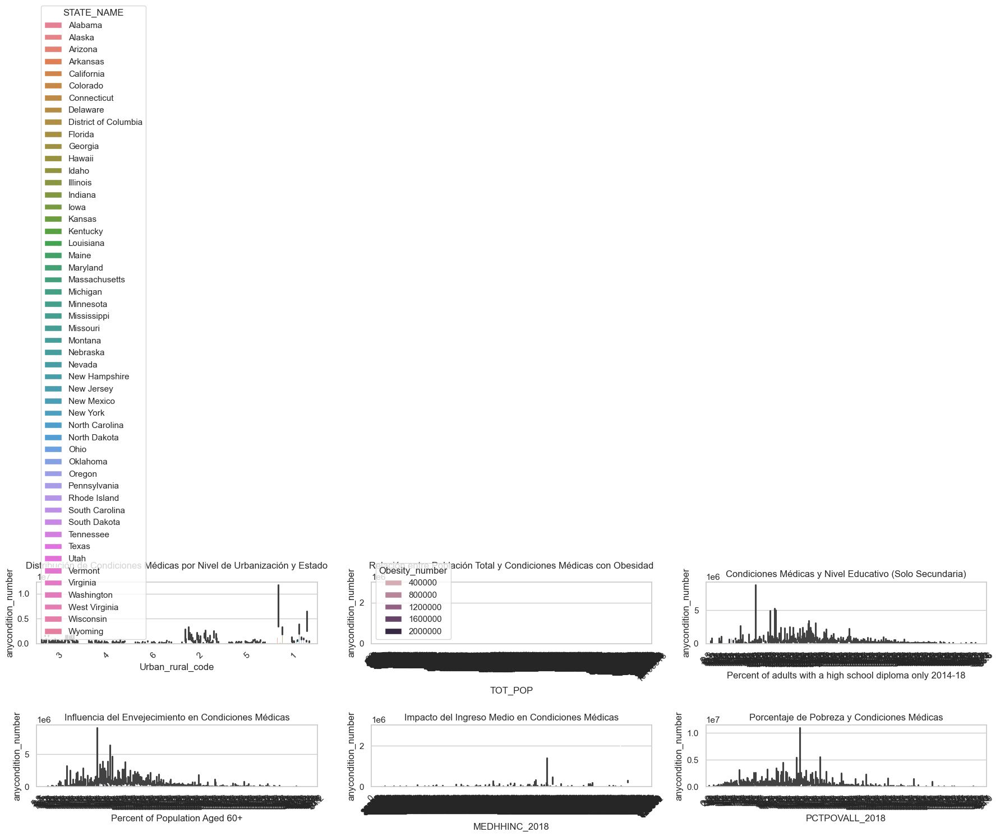

In [70]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("whitegrid")

fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Gráfico 1: Urbanización vs. Condición médica con hue por estado
sns.barplot(ax=axes[0, 0], data=total_data, x="Urban_rural_code", y="anycondition_number", hue="STATE_NAME", estimator=sum)
axes[0, 0].set_title("Distribución de Condiciones Médicas por Nivel de Urbanización y Estado")

# Gráfico 2: Población total vs. Condiciones médicas con hue por obesidad
sns.barplot(ax=axes[0, 1], data=total_data, x="TOT_POP", y="anycondition_number", hue="Obesity_number", estimator=sum)
axes[0, 1].set_title("Relación entre Población Total y Condiciones Médicas con Obesidad")

# Gráfico 3: Nivel educativo vs. Condiciones médicas
sns.barplot(ax=axes[0, 2], data=total_data, x="Percent of adults with a high school diploma only 2014-18", y="anycondition_number", estimator=sum)
axes[0, 2].set_title("Condiciones Médicas y Nivel Educativo (Solo Secundaria)")

# Gráfico 4: Rango etario 60+ vs. Condiciones médicas
sns.barplot(ax=axes[1, 0], data=total_data, x="Percent of Population Aged 60+", y="anycondition_number", estimator=sum)
axes[1, 0].set_title("Influencia del Envejecimiento en Condiciones Médicas")

# Gráfico 5: Ingreso medio vs. Condiciones médicas
sns.barplot(ax=axes[1, 1], data=total_data, x="MEDHHINC_2018", y="anycondition_number", estimator=sum)
axes[1, 1].set_title("Impacto del Ingreso Medio en Condiciones Médicas")

# Gráfico 6: Pobreza vs. Condiciones médicas
sns.barplot(ax=axes[1, 2], data=total_data, x="PCTPOVALL_2018", y="anycondition_number", estimator=sum)
axes[1, 2].set_title("Porcentaje de Pobreza y Condiciones Médicas")

# Ajustes de diseño
for ax in axes.flat:
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

plt.tight_layout()
plt.show()


Hay tantos datos a la hora de graficar, que no permite hacer un buen análisis de los datos

In [74]:
#- categoricas --> urban_rural_code, county_name, state_name
total_data["Urban_rural_code_n"], Urban_rural_code_labels = pd.factorize(total_data["Urban_rural_code"])
total_data["COUNTY_NAME_n"], COUNTY_NAME_labels = pd.factorize(total_data["COUNTY_NAME"])
total_data["STATE_NAME_n"], STATE_NAME_labels = pd.factorize(total_data["STATE_NAME"])

# Crear diccionarios de transformación
Urban_rural_code_transformation_rules = {label: idx for idx, label in enumerate(Urban_rural_code_labels)}
COUNTY_NAME_transformation_rules = {label: idx for idx, label in enumerate(COUNTY_NAME_labels)}
STATE_NAME_transformation_rules = {label: idx for idx, label in enumerate(STATE_NAME_labels)}

# Guardar las reglas en archivos JSON
with open("Urban_rural_code_transformation_rules.json", "w") as f:
    json.dump(Urban_rural_code_transformation_rules, f)

with open("COUNTY_NAME_transformation_rules.json", "w") as f:
    json.dump(COUNTY_NAME_transformation_rules, f)

with open("STATE_NAME_transformation_rules.json", "w") as f:
    json.dump(STATE_NAME_transformation_rules, f)

# Mostrar los valores únicos transformados
print("Transformaciones aplicadas y guardadas en JSON.")
print("Urban_rural_code:", Urban_rural_code_transformation_rules)
print("COUNTY_NAME:", COUNTY_NAME_transformation_rules)
print("STATE_NAME:", STATE_NAME_transformation_rules)


Transformaciones aplicadas y guardadas en JSON.
Urban_rural_code: {'3': 0, '4': 1, '6': 2, '2': 3, '5': 4, '1': 5}
COUNTY_NAME: {'Autauga': 0, 'Baldwin': 1, 'Barbour': 2, 'Bibb': 3, 'Blount': 4, 'Bullock': 5, 'Butler': 6, 'Calhoun': 7, 'Chambers': 8, 'Cherokee': 9, 'Chilton': 10, 'Choctaw': 11, 'Clarke': 12, 'Clay': 13, 'Cleburne': 14, 'Coffee': 15, 'Colbert': 16, 'Conecuh': 17, 'Coosa': 18, 'Covington': 19, 'Crenshaw': 20, 'Cullman': 21, 'Dale': 22, 'Dallas': 23, 'DeKalb': 24, 'Elmore': 25, 'Escambia': 26, 'Etowah': 27, 'Fayette': 28, 'Franklin': 29, 'Geneva': 30, 'Greene': 31, 'Hale': 32, 'Henry': 33, 'Houston': 34, 'Jackson': 35, 'Jefferson': 36, 'Lamar': 37, 'Lauderdale': 38, 'Lawrence': 39, 'Lee': 40, 'Limestone': 41, 'Lowndes': 42, 'Macon': 43, 'Madison': 44, 'Marengo': 45, 'Marion': 46, 'Marshall': 47, 'Mobile': 48, 'Monroe': 49, 'Montgomery': 50, 'Morgan': 51, 'Perry': 52, 'Pickens': 53, 'Pike': 54, 'Randolph': 55, 'Russell': 56, 'St. Clair': 57, 'Shelby': 58, 'Sumter': 59, 'Ta

In [75]:
total_data

,TOT_POP,0-9,0-9 y/o % of total pop,19-Oct,10-19 y/o % of total pop,20-29,20-29 y/o % of total pop,30-39,30-39 y/o % of total pop,40-49,40-49 y/o % of total pop,50-59,50-59 y/o % of total pop,60-69,60-69 y/o % of total pop,70-79,70-79 y/o % of total pop,80+,80+ y/o % of total pop,White-alone pop,% White-alone,Black-alone pop,% Black-alone,Native American/American Indian-alone pop,% NA/AI-alone,Asian-alone pop,% Asian-alone,Hawaiian/Pacific Islander-alone pop,% Hawaiian/PI-alone,Two or more races pop,% Two or more races,POP_ESTIMATE_2018,N_POP_CHG_2018,GQ_ESTIMATES_2018,R_birth_2018,R_death_2018,R_NATURAL_INC_2018,Less than a high school diploma 2014-18,High school diploma only 2014-18,Some college or associate's degree 2014-18,Bachelor's degree or higher 2014-18,Percent of adults with less than a high school diploma 2014-18,Percent of adults with a high school diploma only 2014-18,Percent of adults completing some college or associate's degree 2014-18,Percent of adults with a bachelor's degree or higher 2014-18,POVALL_2018,PCTPOVALL_2018,PCTPOV017_2018,PCTPOV517_2018,MEDHHINC_2018,CI90LBINC_2018,CI90UBINC_2018,Civilian_labor_force_2018,Employed_2018,Unemployed_2018,Unemployment_rate_2018,Median_Household_Income_2018,Med_HH_Income_Percent_of_State_Total_2018,Active Physicians per 100000 Population 2018 (AAMC),Total Active Patient Care Physicians per 100000 Population 2018 (AAMC),Active Primary Care Physicians per 100000 Population 2018 (AAMC),Active Patient Care Primary Care Physicians per 100000 Population 2018 (AAMC),Active General Surgeons per 100000 Population 2018 (AAMC),Active Patient Care General Surgeons per 100000 Population 2018 (AAMC),Total nurse practitioners (2019),Total physician assistants (2019),Total Hospitals (2019),Internal Medicine Primary Care (2019),Family Medicine/General Practice Primary Care (2019),Total Specialist Physicians (2019),ICU Beds_x,Total Population,Population Aged 60+,Percent of Population Aged 60+,COUNTY_NAME,STATE_NAME,CNTY_FIPS,county_pop2018_18 and older,anycondition_prevalence,anycondition_number,Obesity_prevalence,Obesity_number,Heart disease_prevalence,Heart disease_number,COPD_prevalence,COPD_number,diabetes_prevalence,diabetes_number,CKD_prevalence,CKD_number,Urban_rural_code,Urban_rural_code_n,COUNTY_NAME_n,STATE_NAME_n
0,55601,6787,12.206615,7637,13.735364,6878,12.370281,7089,12.749771,7582,13.636445,7738,13.917016,5826,10.478229,4050,7.284042,2014,3.622237,42660,76.725239,10915,19.630942,267,0.480207,681,1.224798,62,0.111509,1016,1.827305,55601,158,455,11.8,9.6,2.2,4204,12119,10552,10291,11.3,32.6,28.4,27.7,7587,13.8,19.3,19.5,59338,53628,65048,25957,25015,942,3.6,59338,119.0,217.1,196.7,77.2,71.2,7.6,6.9,28.859137,6.085786,1.148905,25.992561,21.249061,72.142154,6,55036,10523,19.1,Autauga,Alabama,1,42438,47.6,20181,35.8,15193,7.9,3345,8.6,3644,12.9,5462,3.1,1326,3,0,0,0
1,218022,24757,11.355276,26913,12.344167,23579,10.814964,25213,11.564429,27338,12.539102,29986,13.753658,29932,13.728890,20936,9.602701,9368,4.296814,190301,87.285228,19492,8.940382,1684,0.772399,2508,1.150343,146,0.066966,3891,1.784682,218022,5403,2190,10.5,10.3,0.1,14310,40579,46025,46075,9.7,27.6,31.3,31.3,21069,9.8,13.9,13.1,57588,54437,60739,93849,90456,3393,3.6,57588,115.5,217.1,196.7,77.2,71.2,7.6,6.9,113.162114,23.863512,4.505074,101.921730,83.321572,282.882982,51,203360,53519,26.3,Baldwin,Alabama,3,170912,40.2,68790,29.7,50761,7.8,13414,8.6,14692,12.0,20520,3.2,5479,4,1,1,0
2,24881,2732,10.980266,2960,11.896628,3268,13.134520,3201,12.865239,3074,12.354809,3278,13.174712,3076,12.362847,2244,9.018930,1048,4.212049,12209,49.069571,12042,48.398376,164,0.659137,113,0.454162,46,0.184880,307,1.233873,24881,-277,2820,10.4,12.9,-2.5,4901,6486,4566,2220,27.0,35.7,25.1,12.2,6788,30.9,43.9,36.7,34382,31157,37607,8373,7940,433,5.2,34382,68.9,217.1,196.7,77.2,71.2,7.6,6.9,12.914231,2.723340,0.514126,11.631462,9.508784,32.283033,5,26201,6150,23.5,Barbour,Alabama,5,19689,57.5,11325,40.7,8013,11.0,2159,12.1,2373,19.7,3870

In [76]:
numericals_variables = list(set(total_data.columns) - set(categorical_variables))

In [95]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Número de partes en que dividiremos las variables
num_vars = len(numericals_variables)
num_parts = min(6, num_vars // 10)  # Aseguramos divisiones eficientes
chunk_size = num_vars // num_parts

# Crear las listas de variables divididas
split_vars = [numericals_variables[i * chunk_size : (i + 1) * chunk_size] for i in range(num_parts)]
if num_vars % num_parts != 0:
    split_vars[-1].extend(numericals_variables[num_parts * chunk_size:])

# Crear figura con un tamaño GIGANTE
fig, axes = plt.subplots(num_parts, 1, figsize=(200, 500))  # Más alto y ancho

for i, vars_subset in enumerate(split_vars):
    sns.heatmap(
        total_data[vars_subset].corr(), 
        annot=True, fmt=".2f", cmap="coolwarm", ax=axes[i], 
        annot_kws={"size": 80}  # Aumentamos el tamaño de los números a 80
    )
    
    axes[i].set_title(f"🔍 Heatmap - Parte {i+1}", fontsize=120, pad=80)  # Títulos más grandes
    axes[i].tick_params(axis='x', labelsize=100, rotation=0)  # Etiquetas del eje X en horizontal, grandes
    axes[i].tick_params(axis='y', labelsize=100, rotation=0)  # Etiquetas del eje Y en horizontal, grandes

# Más espacio entre los gráficos para máxima legibilidad
plt.subplots_adjust(hspace=1.5)  # Mucho más espacio entre heatmaps

plt.show()





/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/seaborn/utils.py:61: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) Arial.
  fig.canvas.draw()
/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/seaborn/utils.py:61: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) Arial.
  fig.canvas.draw()
/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/seaborn/utils.py:61: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) Arial.
  fig.canvas.draw()
/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/seaborn/utils.py:61: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFYING GLASS}) missing from font(s) Arial.
  fig.canvas.draw()
/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/seaborn/utils.py:61: UserWarning: Glyph 128269 (\N{LEFT-POINTING MAGNIFY